In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
import glob


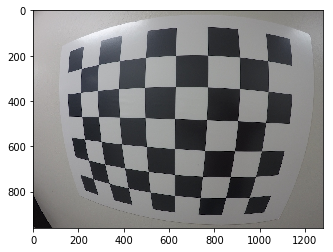

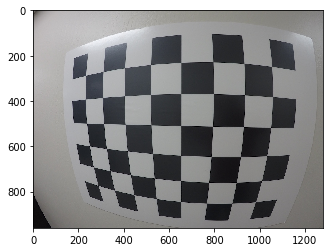

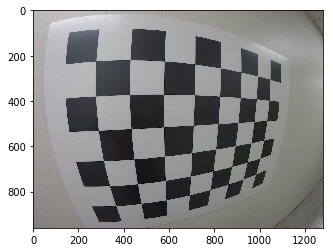

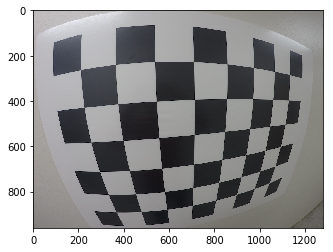

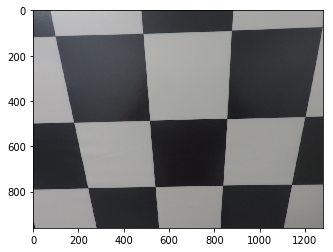

...

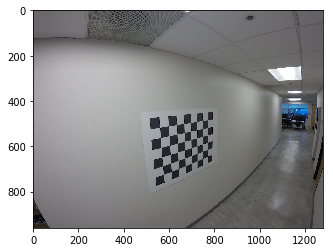

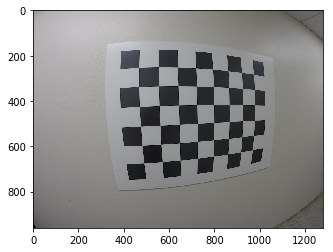

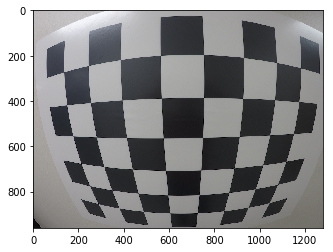

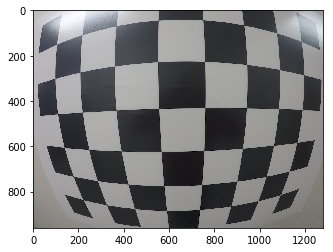

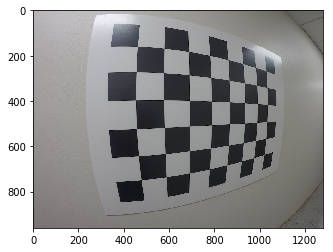

In [2]:
%matplotlib inline
for fname in os.listdir('calibration_wide'):
    if fname.endswith('.jpg'):
        img = cv2.imread(os.path.join('calibration_wide', fname))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img)
        plt.show()

In [3]:
nx, ny = 8, 6

def calibrate_camera(image_path, nx, ny):
    
    imgp_list = [] # image points
    corner_list = []
    image_list = []
    
    for n, fname in enumerate(os.listdir(image_path)):
        if fname.endswith('.jpg') and fname.split('.')[0].split('_')[0]!='test':
            img = cv2.imread(os.path.join(image_path, fname))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
            ret, corners = cv2.findChessboardCorners(img, (nx, ny))

            if ret:
                cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
                imgp_list.append(corners)
                corner_list.append(corners)
                image_list.append(img)

    n_pictures = len(imgp_list)
    imgp_list = np.array(imgp_list)
    objp = np.zeros((nx * ny, 3), np.float32)
    objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)
    objp_list = np.repeat(objp[None, :, :], n_pictures, axis=0)
    
    retval, cameraMatrix, distCoeffs, rvecs, tvecs = \
    cv2.calibrateCamera(objp_list, imgp_list, img.shape[1::-1], None, None)
    
    return retval, cameraMatrix, distCoeffs, rvecs, tvecs, corner_list, image_list, objp_list

In [4]:
retval, cameraMatrix, distCoeffs, rvecs, tvecs, corner_list, image_list, objp_list = \
calibrate_camera('calibration_wide', 8, 6)

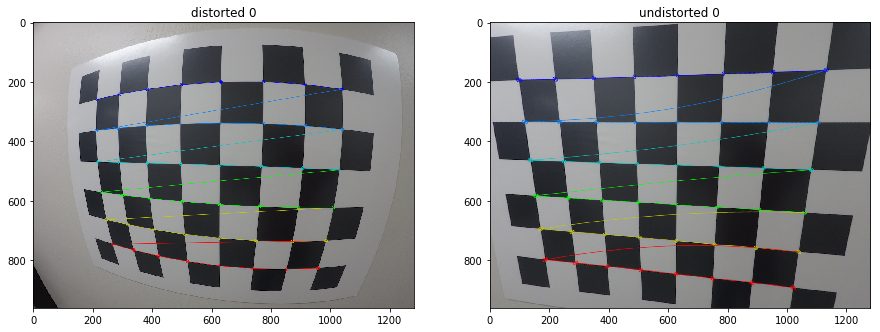

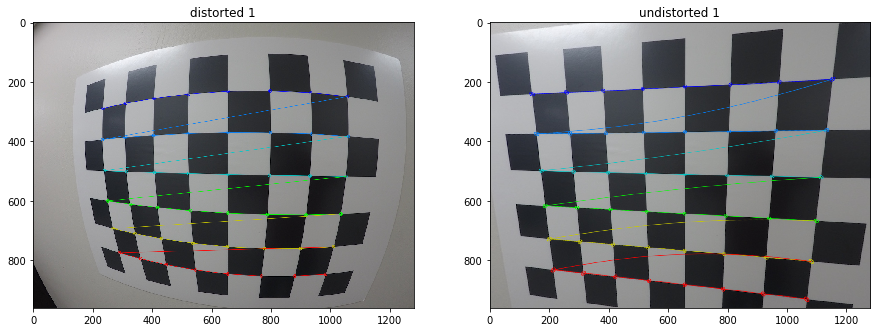

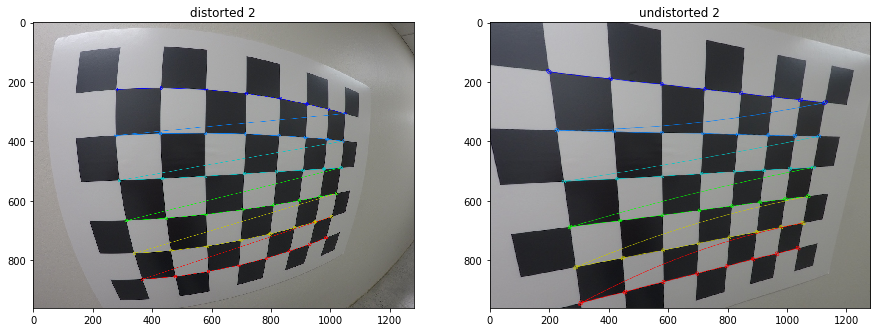

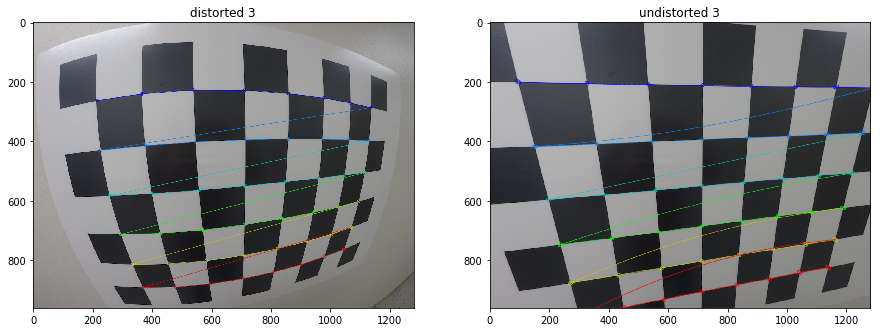

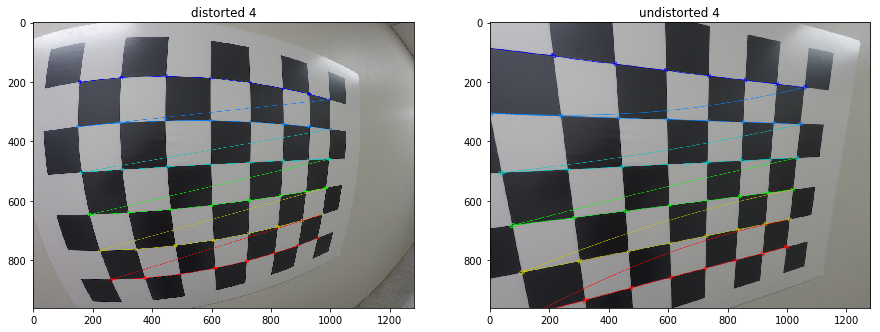

...

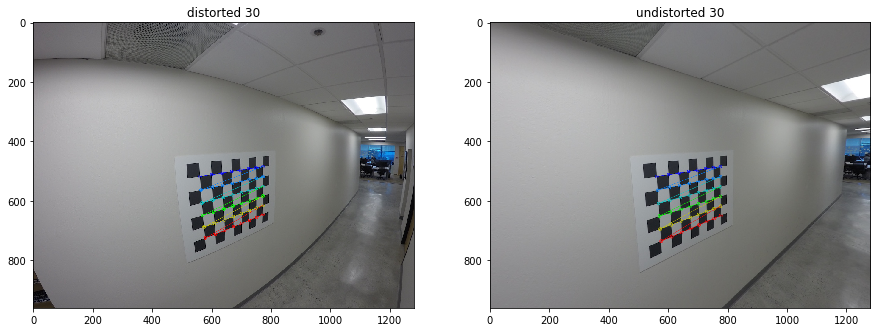

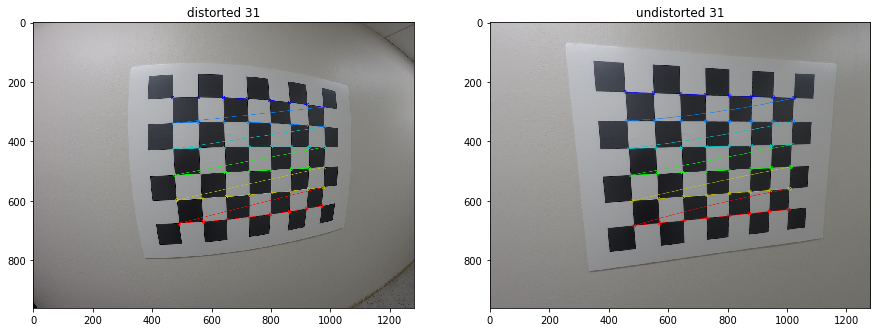

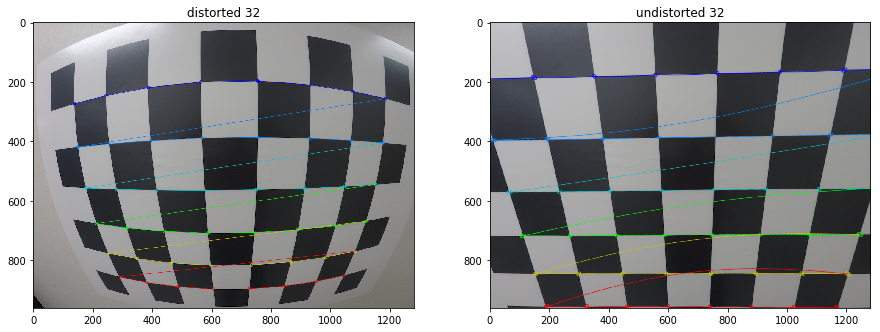

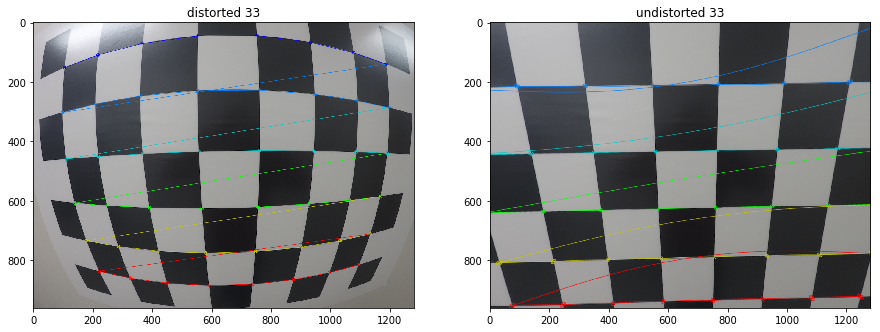

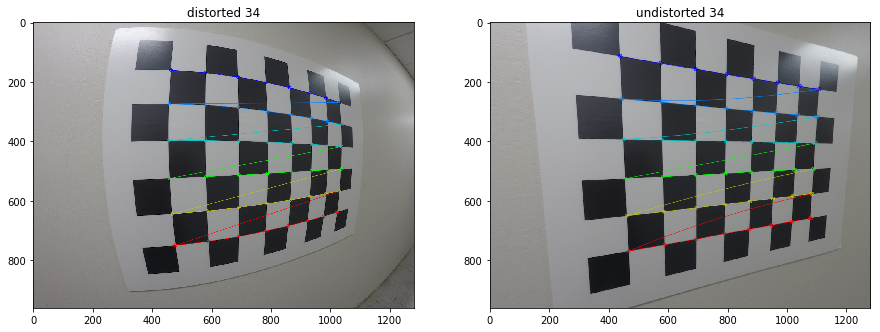

In [5]:
%matplotlib inline
image_distort = []
image_undistort = []
for n, img in enumerate(image_list):  
    plt.figure(figsize=(15, 20))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title('distorted {}'.format(n))
    img_undistorted = cv2.undistort(img, cameraMatrix, distCoeffs, None, cameraMatrix)
    plt.subplot(1, 2, 2)
    plt.imshow(img_undistorted)
    plt.title('undistorted {}'.format(n))
    plt.show()
    image_distort.append(img)
    image_undistort.append(img_undistorted)

In [6]:
import pickle
with open('calibration_wide/wide_dist_pickle.p', 'rb') as pfile:
    a = pickle.load(pfile)

In [7]:
((a['dist']-distCoeffs)**2).mean()

3.1929722352657662e-09

In [8]:
(((a['mtx']-cameraMatrix))**2).mean()/(a['mtx']**2).mean()

5.659695444868973e-09

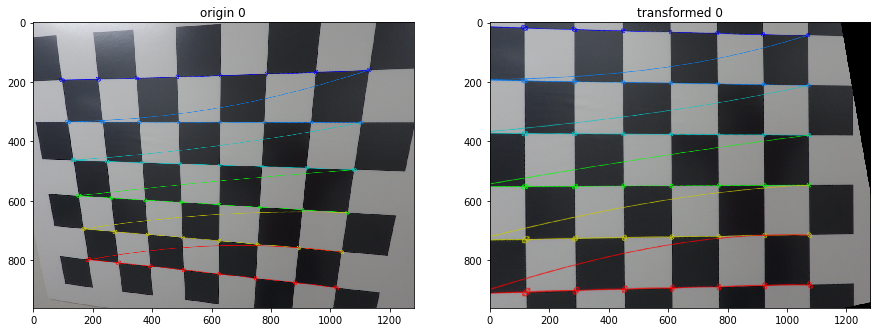

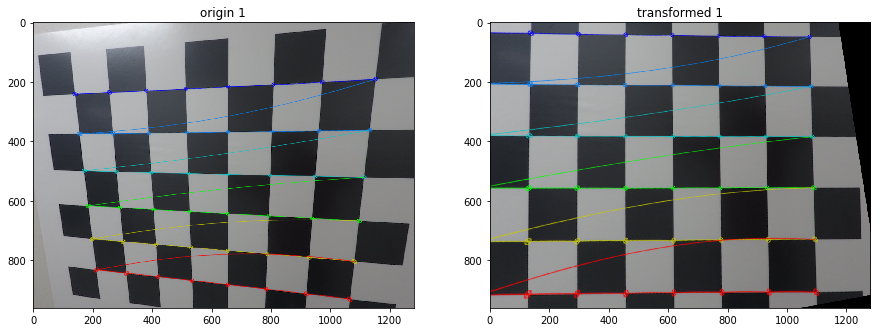

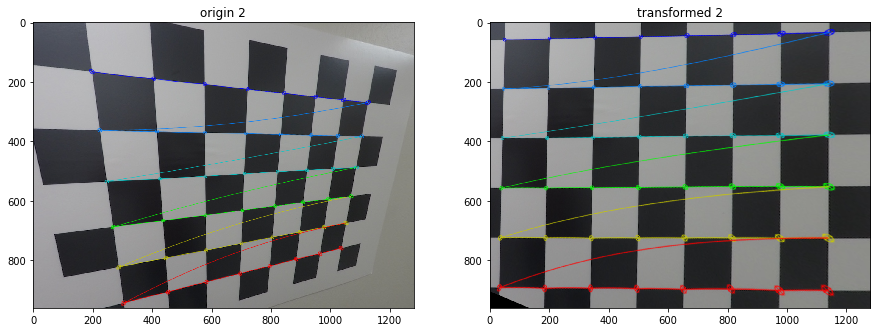

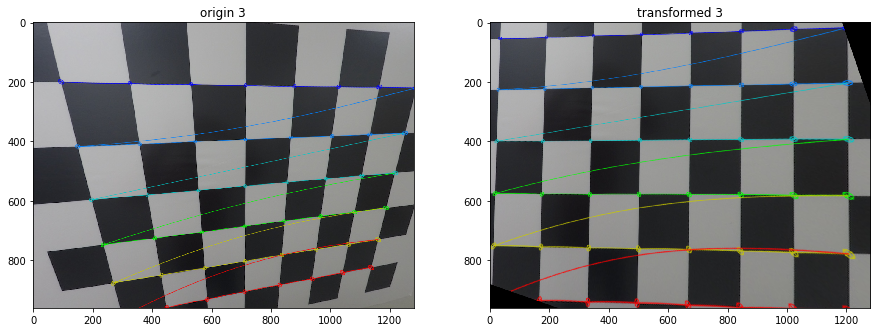

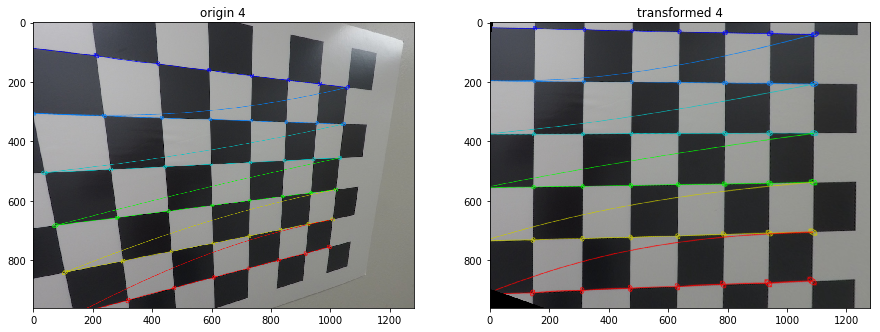

...

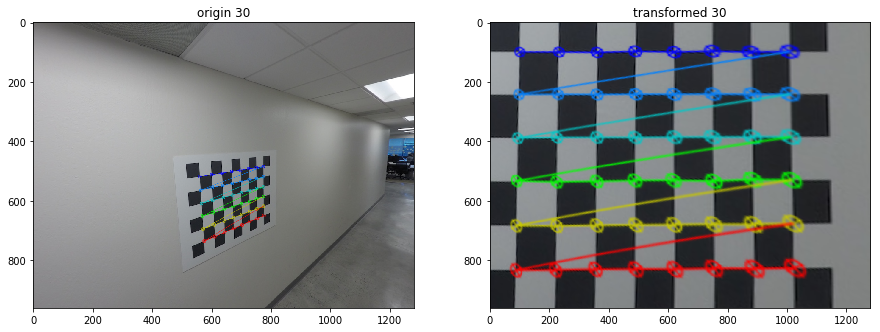

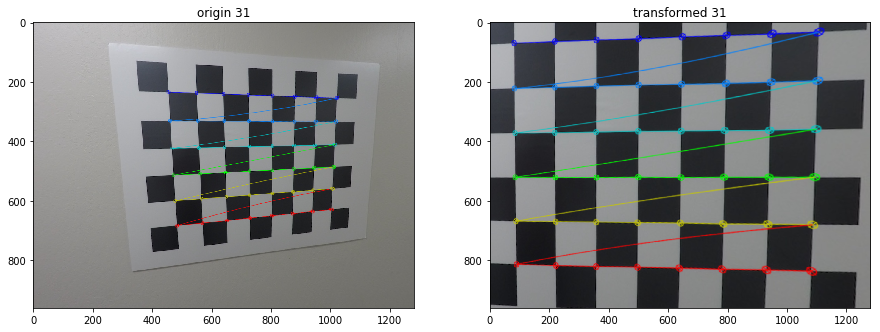

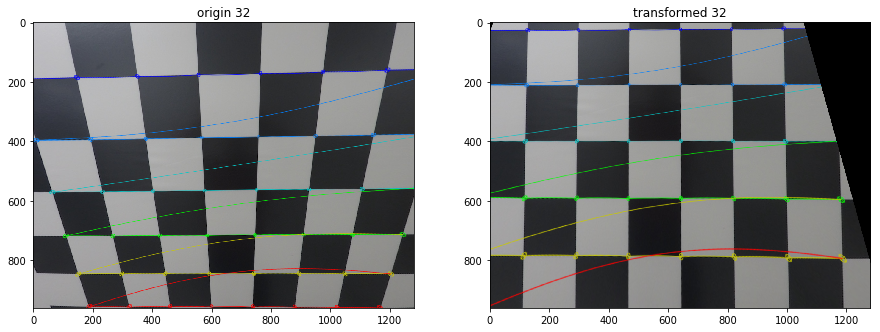

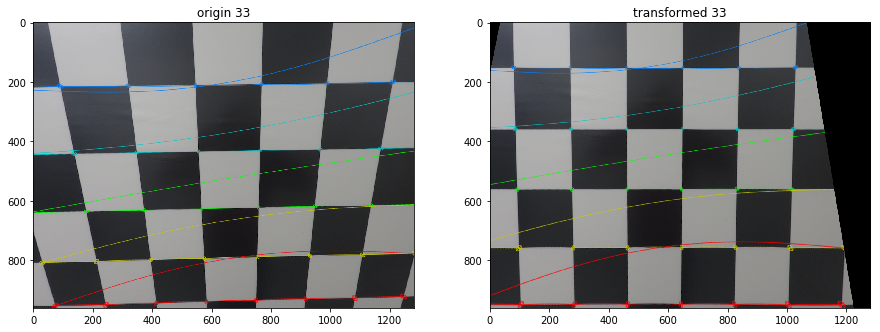

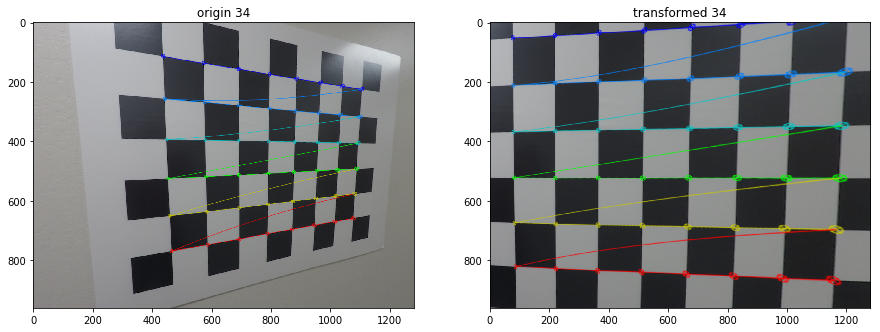

In [9]:
dst = np.array([[100, 100], [1000, 100], [100, 800], [1000, 800]], dtype=np.float32)
for n, img in enumerate(image_undistort):
    corners = corner_list[n]
    src = np.squeeze(corners[[0, 7, 40, 47]]).astype(np.float32)
    M = cv2.getPerspectiveTransform(src, dst)
    img_perspective = cv2.warpPerspective(img, M, img.shape[1::-1], flags=cv2.INTER_LINEAR)
    plt.figure(figsize=(15, 20))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title('origin {}'.format(n))
    plt.subplot(1, 2, 2)
    plt.imshow(img_perspective)
    plt.title('transformed {}'.format(n))
    plt.show()

In [10]:
corner_list[11][0]

array([[824.99316, 242.59988]], dtype=float32)